In [44]:
# Install the Ultralytics library
!pip install ultralytics -q

In [45]:
# file structure
import numpy as np
import pandas as pd
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    print(dirname)

/kaggle/input
/kaggle/input/weld-data
/kaggle/input/weld-data/weld_defect_dataset
/kaggle/input/weld-data/weld_defect_dataset/labels
/kaggle/input/weld-data/weld_defect_dataset/labels/valid
/kaggle/input/weld-data/weld_defect_dataset/labels/test
/kaggle/input/weld-data/weld_defect_dataset/labels/train
/kaggle/input/weld-data/weld_defect_dataset/images
/kaggle/input/weld-data/weld_defect_dataset/images/valid
/kaggle/input/weld-data/weld_defect_dataset/images/test
/kaggle/input/weld-data/weld_defect_dataset/images/train


In [46]:
%%writefile weld_data.yaml
train: /kaggle/input/weld-data/weld_defect_dataset/images/train
val: /kaggle/input/weld-data/weld_defect_dataset/images/valid
test: /kaggle/input/weld-data/weld_defect_dataset/images/test
nc: 5
names: ['adjacent', 'integrity', 'geometry', 'postprocessing', 'nonfulfillment']

Writing weld_data.yaml


1152
****************************************
Images From the training dataset
****************************************


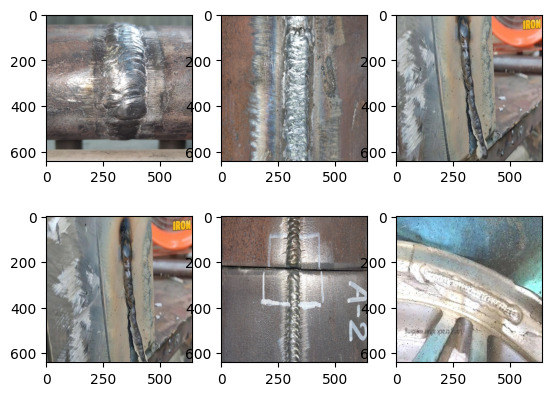

In [47]:
# Few Images from the training dataset
images_paths=[]
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
for image_path in os.listdir('/kaggle/input/weld-data/weld_defect_dataset/images/train'):
    images_paths.append(os.path.join('/kaggle/input/weld-data/weld_defect_dataset/images/train',image_path))
print(len(images_paths))
print("*"*40)
print("Images From the training dataset")
print('*'*40)
for i in range(len(images_paths[6])):
    if i>=6:
        break
    plt.subplot(2,3,i+1)
    image=mpimg.imread(images_paths[i])
    plt.imshow(image)

In [48]:
from ultralytics import YOLO

# Loading a pre-trained YOLO model (choosing yolov8n as it is small and fast model)
model = YOLO('yolov8n.pt')

# Training the model using our own dataset
results = model.train(
    data='weld_data.yaml',
    epochs=100,
    imgsz=640,              
    batch=16,
    name='yolov8_weld_defect_detection'
)

100%|██████████| 6.25M/6.25M [00:00<00:00, 18.5MB/s]


Ultralytics 8.3.168 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=weld_data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8_weld_defect_detection, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True,

100%|██████████| 5.35M/5.35M [00:00<00:00, 16.2MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 292.7±155.6 MB/s, size: 166.6 KB)


train: Scanning /kaggle/input/weld-data/weld_defect_dataset/labels/train... 1152 images, 113 backgrounds, 0 corrupt: 100%|██████████| 1152/1152 [00:00<00:00, 1225.33it/s]

WARNING ⚠️ train: Cache directory /kaggle/input/weld-data/weld_defect_dataset/labels is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 232.0±142.8 MB/s, size: 172.2 KB)


val: Scanning /kaggle/input/weld-data/weld_defect_dataset/labels/valid... 210 images, 20 backgrounds, 0 corrupt: 100%|██████████| 210/210 [00:00<00:00, 612.40it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/weld-data/weld_defect_dataset/labels is not writeable, cache not saved.


Plotting labels to runs/detect/yolov8_weld_defect_detection/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/yolov8_weld_defect_detection
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.34G      2.498      4.378      1.889         92        640: 100%|██████████| 72/72 [00:14<00:00,  5.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.95it/s]

                   all        210        602    0.00384      0.405     0.0648     0.0206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.59G      2.294      3.402      1.689         55        640: 100%|██████████| 72/72 [00:13<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.34it/s]

                   all        210        602      0.504      0.171      0.104     0.0327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.59G      2.253      3.052      1.673         59        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  4.89it/s]

                   all        210        602       0.18      0.313      0.162     0.0589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.59G      2.215      2.753      1.671         83        640: 100%|██████████| 72/72 [00:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.67it/s]

                   all        210        602      0.245       0.27      0.191     0.0641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.59G      2.173      2.558      1.639         55        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.65it/s]

                   all        210        602      0.272      0.394      0.266      0.101



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.59G      2.136      2.387      1.621         72        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.74it/s]

                   all        210        602       0.41      0.412      0.366      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.59G      2.114      2.286      1.603         62        640: 100%|██████████| 72/72 [00:13<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.85it/s]

                   all        210        602      0.515      0.372      0.387      0.166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.59G      2.065      2.197      1.564         38        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.71it/s]

                   all        210        602      0.492      0.418       0.43      0.165



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100       2.6G      2.039      2.056       1.55         60        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.92it/s]

                   all        210        602      0.526      0.496      0.464      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.62G      2.033      1.984      1.548         53        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.69it/s]

                   all        210        602      0.573       0.47      0.489      0.224



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.63G      2.011      1.899      1.522         64        640: 100%|██████████| 72/72 [00:13<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.95it/s]

                   all        210        602      0.564      0.499      0.491      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.65G      1.945      1.821      1.482         52        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.06it/s]

                   all        210        602      0.577      0.515      0.527      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.67G      1.955      1.764      1.478        116        640: 100%|██████████| 72/72 [00:13<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.98it/s]

                   all        210        602      0.567      0.505      0.533      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.68G       1.92      1.724      1.447         51        640: 100%|██████████| 72/72 [00:13<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.16it/s]

                   all        210        602      0.676      0.524      0.583      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100       2.7G      1.904      1.685      1.457         48        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.89it/s]

                   all        210        602      0.613      0.569      0.597      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.72G       1.87      1.636      1.432         50        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.98it/s]

                   all        210        602      0.562      0.561      0.572      0.268



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.73G      1.896      1.643       1.43         51        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.36it/s]

                   all        210        602      0.666      0.548      0.591      0.254



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.75G      1.881      1.627      1.437         47        640: 100%|██████████| 72/72 [00:13<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.93it/s]

                   all        210        602      0.682      0.548      0.601      0.267



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.77G      1.845      1.551      1.424         61        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.96it/s]

                   all        210        602        0.7      0.568      0.657      0.302



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.79G      1.851      1.501      1.385         64        640: 100%|██████████| 72/72 [00:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.82it/s]

                   all        210        602       0.68      0.559      0.635       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       2.8G      1.841      1.488      1.383         48        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.86it/s]

                   all        210        602      0.672      0.653      0.683      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.82G      1.826      1.475       1.39         40        640: 100%|██████████| 72/72 [00:13<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.84it/s]

                   all        210        602       0.65      0.569      0.617      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.84G      1.805      1.462      1.362         74        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.14it/s]

                   all        210        602      0.746       0.65      0.721      0.308



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.86G      1.857       1.45      1.393         65        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.09it/s]

                   all        210        602        0.7      0.662      0.713      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.87G      1.801      1.427      1.367         66        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.93it/s]

                   all        210        602      0.742      0.645      0.713      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.89G      1.779      1.347      1.332         84        640: 100%|██████████| 72/72 [00:13<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.49it/s]

                   all        210        602      0.688      0.634      0.677      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.91G      1.785      1.366      1.351         84        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.96it/s]

                   all        210        602       0.76      0.606       0.68      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.92G      1.747      1.317      1.332         65        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.99it/s]

                   all        210        602      0.751      0.658      0.696       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.94G      1.753      1.338      1.326         48        640: 100%|██████████| 72/72 [00:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.24it/s]

                   all        210        602      0.762      0.669      0.734      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.96G      1.734       1.33      1.338         60        640: 100%|██████████| 72/72 [00:12<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.10it/s]

                   all        210        602      0.743      0.631      0.698      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.97G      1.748      1.275      1.319         55        640: 100%|██████████| 72/72 [00:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.96it/s]

                   all        210        602      0.733      0.691      0.731      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.99G      1.735      1.262      1.321         62        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.13it/s]

                   all        210        602        0.7      0.704      0.735      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      3.01G      1.733      1.263      1.313         50        640: 100%|██████████| 72/72 [00:13<00:00,  5.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.05it/s]

                   all        210        602      0.776       0.68      0.736      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      3.03G      1.722      1.229      1.306         36        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.91it/s]

                   all        210        602      0.785      0.679      0.758       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      3.04G      1.722      1.243      1.306         83        640: 100%|██████████| 72/72 [00:13<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.03it/s]

                   all        210        602      0.762      0.711      0.766      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      3.06G      1.684      1.211      1.286         71        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.81it/s]

                   all        210        602      0.728      0.694      0.739      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.08G      1.706      1.227      1.296         82        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.63it/s]

                   all        210        602      0.746      0.696      0.743      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      3.09G      1.707      1.175      1.303         60        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.21it/s]

                   all        210        602      0.793      0.712      0.785       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.11G        1.7      1.199      1.303         61        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.21it/s]

                   all        210        602      0.791      0.706      0.768      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.13G      1.676      1.182      1.289         57        640: 100%|██████████| 72/72 [00:13<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.01it/s]

                   all        210        602      0.813      0.689      0.768      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      3.14G      1.674      1.185      1.283         53        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.26it/s]

                   all        210        602      0.765      0.706      0.749      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      3.16G      1.647      1.114      1.261         60        640: 100%|██████████| 72/72 [00:13<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.00it/s]

                   all        210        602      0.828      0.745      0.814      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      3.18G      1.636      1.127      1.258         58        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.07it/s]

                   all        210        602      0.767       0.74      0.769       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       3.2G       1.64      1.109      1.251         53        640: 100%|██████████| 72/72 [00:13<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.04it/s]

                   all        210        602      0.784      0.712      0.761       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.21G      1.622       1.11      1.269         61        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.19it/s]

                   all        210        602      0.798      0.753      0.794      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      3.23G      1.636      1.112      1.259         58        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.56it/s]

                   all        210        602      0.792      0.758        0.8      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      3.25G      1.629      1.111       1.24         76        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.04it/s]

                   all        210        602       0.78      0.696       0.77      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      3.27G      1.615      1.086      1.251         57        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.72it/s]

                   all        210        602      0.795      0.749      0.764      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.28G      1.614      1.073      1.243         61        640: 100%|██████████| 72/72 [00:13<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.06it/s]

                   all        210        602      0.811      0.767      0.798      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       3.3G       1.59      1.057      1.237         53        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.19it/s]

                   all        210        602       0.81      0.771      0.792      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.32G      1.583      1.049      1.228         76        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.14it/s]

                   all        210        602      0.804      0.778       0.81      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      3.33G      1.581      1.066      1.219         76        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.06it/s]

                   all        210        602      0.786      0.712      0.758      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      3.35G      1.584      1.054       1.25         66        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.78it/s]

                   all        210        602      0.775      0.745      0.782      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      3.37G      1.568      1.021      1.217         51        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.18it/s]

                   all        210        602      0.788      0.774      0.807      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.38G      1.582      1.034      1.242         75        640: 100%|██████████| 72/72 [00:13<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.81it/s]

                   all        210        602      0.817      0.759      0.814      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100       3.4G      1.567      1.037      1.217         73        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.05it/s]

                   all        210        602      0.825      0.748      0.807      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      3.42G      1.584      1.029      1.223         64        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.45it/s]

                   all        210        602        0.8      0.725      0.794      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      3.44G      1.573      1.018      1.232         81        640: 100%|██████████| 72/72 [00:13<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.09it/s]

                   all        210        602      0.811      0.789      0.819      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.45G      1.537     0.9852      1.211         63        640: 100%|██████████| 72/72 [00:12<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.22it/s]

                   all        210        602      0.775      0.774      0.816      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      3.47G      1.531     0.9714      1.195         78        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.23it/s]

                   all        210        602      0.815      0.768      0.817      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.49G       1.52     0.9615      1.183        102        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.41it/s]

                   all        210        602      0.843       0.75      0.821      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       3.5G      1.554       0.97      1.198         83        640: 100%|██████████| 72/72 [00:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.21it/s]

                   all        210        602      0.834      0.738      0.791      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      3.52G      1.523      0.963      1.194         72        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.28it/s]

                   all        210        602      0.822      0.792      0.833      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.54G      1.517     0.9505       1.19         70        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.09it/s]

                   all        210        602      0.797      0.775      0.813      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.55G      1.499     0.9213      1.179         83        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.29it/s]

                   all        210        602      0.789      0.787      0.816      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.57G      1.505     0.9339      1.184         63        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.04it/s]

                   all        210        602      0.807      0.796      0.822      0.397



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      3.59G      1.492     0.9347      1.162         60        640: 100%|██████████| 72/72 [00:12<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.09it/s]

                   all        210        602      0.815      0.783      0.822       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      3.61G      1.491     0.9332      1.187         48        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.11it/s]

                   all        210        602      0.828      0.779      0.825      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.62G      1.474     0.8979      1.171         68        640: 100%|██████████| 72/72 [00:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.95it/s]

                   all        210        602       0.81      0.768      0.832      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      3.64G      1.484     0.9186      1.171         46        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.12it/s]

                   all        210        602        0.8      0.797      0.823      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      3.66G      1.472     0.8989      1.175         52        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.33it/s]

                   all        210        602      0.823      0.818      0.838      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.67G      1.487     0.9283      1.175         70        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.28it/s]

                   all        210        602      0.834       0.79      0.835      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.69G      1.458     0.8962      1.162         77        640: 100%|██████████| 72/72 [00:13<00:00,  5.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.80it/s]

                   all        210        602       0.83       0.78      0.819      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      3.71G      1.457     0.8879      1.162         40        640: 100%|██████████| 72/72 [00:13<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.12it/s]

                   all        210        602      0.867      0.745      0.832      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.73G      1.436     0.8571      1.152         71        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.22it/s]

                   all        210        602      0.839      0.789      0.839      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      3.74G      1.449     0.8787      1.155         77        640: 100%|██████████| 72/72 [00:12<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.24it/s]

                   all        210        602      0.818      0.803      0.837      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      3.76G      1.463     0.9038      1.163         68        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.34it/s]

                   all        210        602      0.837      0.809      0.842      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      3.78G      1.448     0.8619      1.144         50        640: 100%|██████████| 72/72 [00:13<00:00,  5.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.25it/s]

                   all        210        602      0.814        0.8       0.83       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.79G      1.441     0.8486       1.15         67        640: 100%|██████████| 72/72 [00:12<00:00,  5.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.12it/s]

                   all        210        602      0.844       0.79      0.834      0.412



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.81G      1.417     0.8616      1.145         70        640: 100%|██████████| 72/72 [00:13<00:00,  5.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.92it/s]

                   all        210        602      0.842      0.803      0.843      0.419



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.83G      1.431     0.8624      1.148         68        640: 100%|██████████| 72/72 [00:12<00:00,  5.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.05it/s]

                   all        210        602      0.855      0.773      0.836      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      3.85G       1.42      0.842      1.145         65        640: 100%|██████████| 72/72 [00:13<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.13it/s]

                   all        210        602      0.845      0.807      0.839      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      3.86G      1.399     0.8299      1.128         74        640: 100%|██████████| 72/72 [00:13<00:00,  5.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.14it/s]

                   all        210        602      0.839      0.815      0.841      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      3.88G      1.388      0.832      1.125         55        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.39it/s]

                   all        210        602      0.844       0.81      0.849      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100       3.9G      1.409     0.8323      1.138         79        640: 100%|██████████| 72/72 [00:12<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.95it/s]

                   all        210        602      0.839      0.799      0.837      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      3.91G      1.373     0.8323       1.12         34        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  5.37it/s]

                   all        210        602      0.868      0.777      0.841      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      3.93G      1.389     0.8162      1.121         47        640: 100%|██████████| 72/72 [00:13<00:00,  5.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.25it/s]

                   all        210        602      0.832      0.806      0.847      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      3.95G      1.387     0.8362      1.133         41        640: 100%|██████████| 72/72 [00:13<00:00,  5.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.16it/s]

                   all        210        602       0.85      0.804      0.845      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.96G      1.372     0.7959       1.12         43        640: 100%|██████████| 72/72 [00:13<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.26it/s]

                   all        210        602      0.818      0.812      0.845      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      3.98G      1.377      0.827      1.121         48        640: 100%|██████████| 72/72 [00:13<00:00,  5.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.13it/s]

                   all        210        602      0.851      0.802      0.852      0.429


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         4G      1.372     0.7621      1.134         38        640: 100%|██████████| 72/72 [00:14<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.20it/s]

                   all        210        602      0.822      0.796      0.827      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      4.02G      1.349     0.7312      1.127         45        640: 100%|██████████| 72/72 [00:12<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.25it/s]

                   all        210        602      0.826      0.819      0.844      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.03G       1.33     0.7139      1.112         38        640: 100%|██████████| 72/72 [00:13<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.23it/s]

                   all        210        602      0.816      0.813      0.844      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      4.05G      1.315     0.7094      1.102         49        640: 100%|██████████| 72/72 [00:12<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.20it/s]

                   all        210        602      0.835      0.807      0.843      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.07G      1.322     0.7142      1.104         55        640: 100%|██████████| 72/72 [00:13<00:00,  5.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.13it/s]

                   all        210        602      0.842        0.8      0.843      0.429



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.08G      1.315     0.7032      1.106         47        640: 100%|██████████| 72/72 [00:12<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.38it/s]

                   all        210        602      0.822      0.805       0.84      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       4.1G      1.308     0.6934      1.101         43        640: 100%|██████████| 72/72 [00:12<00:00,  5.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.12it/s]

                   all        210        602      0.831      0.813      0.841       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.12G       1.28     0.6827      1.093         45        640: 100%|██████████| 72/72 [00:13<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.09it/s]

                   all        210        602      0.855       0.79      0.849      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.14G      1.299     0.6805       1.11         37        640: 100%|██████████| 72/72 [00:12<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.46it/s]

                   all        210        602      0.853      0.797      0.848      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.15G      1.288     0.6865      1.094         34        640: 100%|██████████| 72/72 [00:12<00:00,  5.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:01<00:00,  6.37it/s]

                   all        210        602      0.858      0.793      0.847      0.429



100 epochs completed in 0.405 hours.
Optimizer stripped from runs/detect/yolov8_weld_defect_detection/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/yolov8_weld_defect_detection/weights/best.pt, 6.3MB

Validating runs/detect/yolov8_weld_defect_detection/weights/best.pt...
Ultralytics 8.3.168 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:02<00:00,  2.98it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        210        602      0.857      0.791       0.85      0.435
              adjacent         61        238      0.816      0.807      0.842      0.346
             integrity         79        124      0.679      0.546       0.61      0.274
              geometry        115        160      0.925       0.85      0.948       0.56
        postprocessing         31         46      0.864      0.831      0.883      0.397
        nonfulfillment         28         34          1      0.923      0.966      0.599
Speed: 0.2ms preprocess, 2.1ms inference, 0.0ms loss, 3.6ms postprocess per image
Results saved to runs/detect/yolov8_weld_defect_detection


In [49]:
# Loading our custom-trained model
model = YOLO('runs/detect/yolov8_weld_defect_detection/weights/best.pt')

# Evaluating the model's performance on the validation dataset
metrics = model.val()

Ultralytics 8.3.168 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 393.0±88.1 MB/s, size: 204.7 KB)


val: Scanning /kaggle/input/weld-data/weld_defect_dataset/labels/valid... 210 images, 20 backgrounds, 0 corrupt: 100%|██████████| 210/210 [00:00<00:00, 713.31it/s]

WARNING ⚠️ val: Cache directory /kaggle/input/weld-data/weld_defect_dataset/labels is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 14/14 [00:02<00:00,  5.75it/s]
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.11/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


                   all        210        602      0.857      0.783      0.848      0.434
              adjacent         61        238      0.828      0.808      0.843      0.346
             integrity         79        124       0.67      0.532      0.596      0.275
              geometry        115        160      0.924      0.838      0.953       0.56
        postprocessing         31         46      0.864      0.826      0.883      0.393
        nonfulfillment         28         34          1      0.913      0.965      0.597
Speed: 1.2ms preprocess, 2.6ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/val


In [95]:
# Obtained Metrics and other values
import time
image_files_val=[]
for image in os.listdir('runs/detect/val'):
    image_files_val.append(os.path.join('runs/detect/val',image))
image_files_train=[]
for image in os.listdir('runs/detect/yolov8_weld_defect_detection'):
    image_files_train.append(os.path.join('runs/detect/yolov8_weld_defect_detection',image))

24

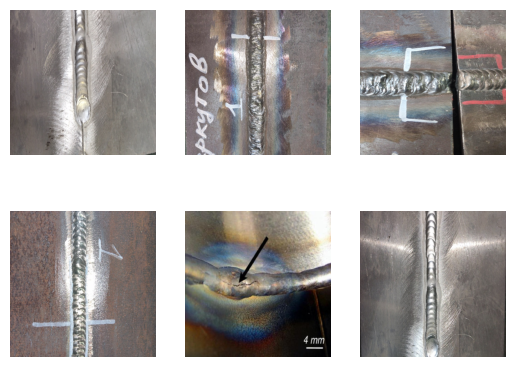

In [93]:
# Few Images from the test dataset
images_paths=[]
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
for image_path in os.listdir('/kaggle/input/weld-data/weld_defect_dataset/images/test'):
    images_paths.append(os.path.join('/kaggle/input/weld-data/weld_defect_dataset/images/test',image_path))
for i in range(len(images_paths[:6])):
    if i!=len(images_paths[:6]):
        image_r=mpimg.imread(images_paths[i])
        plt.subplot(2,3,i+1)
        plt.imshow(image_r)
        plt.axis('off')

In [127]:
from matplotlib.pyplot import plot
results = model.predict(images_paths)
print(results)


0: 640x640 1 integrity, 1 geometry, 1 nonfulfillment, 1.8ms
1: 640x640 2 geometrys, 1.8ms
2: 640x640 1 adjacent, 1 geometry, 1 nonfulfillment, 1.8ms
3: 640x640 1 geometry, 1.8ms
4: 640x640 (no detections), 1.8ms
5: 640x640 1 adjacent, 1 integrity, 1 geometry, 1.8ms
6: 640x640 1 integrity, 1.8ms
7: 640x640 1 adjacent, 2 geometrys, 1.8ms
8: 640x640 2 integritys, 1.8ms
9: 640x640 1 geometry, 1.8ms
10: 640x640 2 integritys, 1.8ms
11: 640x640 7 adjacents, 3 integritys, 2 postprocessings, 1.8ms
12: 640x640 1 geometry, 1.8ms
13: 640x640 2 adjacents, 1 geometry, 1 nonfulfillment, 1.8ms
14: 640x640 6 adjacents, 1.8ms
15: 640x640 1 geometry, 1.8ms
16: 640x640 1 integrity, 2 nonfulfillments, 1.8ms
17: 640x640 1 integrity, 2 geometrys, 1.8ms
18: 640x640 4 integritys, 1.8ms
19: 640x640 2 geometrys, 1 postprocessing, 1.8ms
20: 640x640 7 adjacents, 1 geometry, 2 postprocessings, 1.8ms
21: 640x640 7 adjacents, 2 integritys, 1 postprocessing, 1.8ms
22: 640x640 2 integritys, 1.8ms
23: 640x640 (no detec

Found 3 objects in the image.
  - Defect: integrity
    Confidence: 0.93
    Coordinates: [279.55694580078125, 370.7010498046875, 360.01300048828125, 504.7286376953125]
  - Defect: geometry
    Confidence: 0.70
    Coordinates: [279.69342041015625, 84.5386962890625, 337.0059814453125, 200.7587890625]
  - Defect: nonfulfillment
    Confidence: 0.57
    Coordinates: [304.344970703125, 491.22613525390625, 339.054931640625, 640.0]


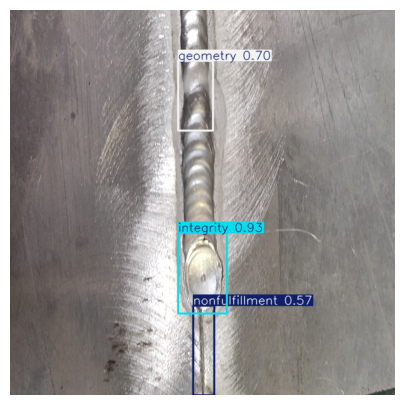

Found 2 objects in the image.
  - Defect: geometry
    Confidence: 0.89
    Coordinates: [274.723876953125, 332.62945556640625, 345.03900146484375, 444.03936767578125]
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [282.53851318359375, 571.9364013671875, 346.37811279296875, 639.8472900390625]


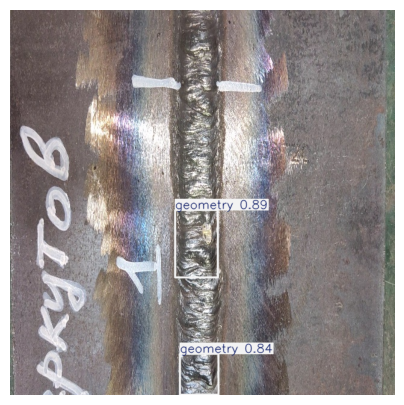

Found 3 objects in the image.
  - Defect: geometry
    Confidence: 0.88
    Coordinates: [79.52227783203125, 267.01849365234375, 142.95458984375, 379.32086181640625]
  - Defect: nonfulfillment
    Confidence: 0.79
    Coordinates: [367.24005126953125, 266.9669189453125, 409.25543212890625, 382.26971435546875]
  - Defect: adjacent
    Confidence: 0.74
    Coordinates: [421.4889221191406, 158.98855590820312, 450.0259094238281, 184.02548217773438]


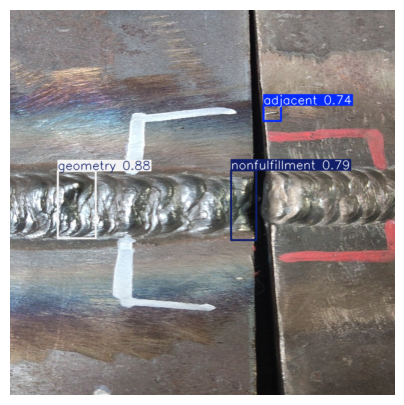

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.83
    Coordinates: [269.83392333984375, 203.26406860351562, 333.10284423828125, 297.24761962890625]


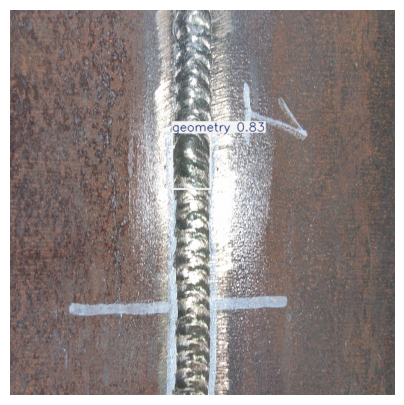

Found 0 objects in the image.


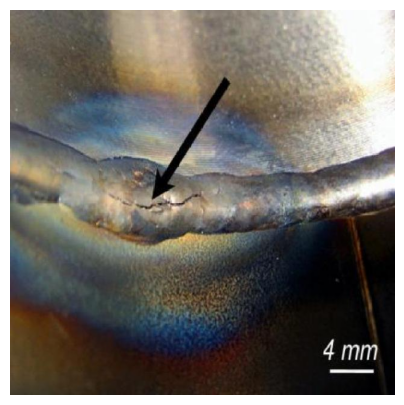

Found 3 objects in the image.
  - Defect: integrity
    Confidence: 0.95
    Coordinates: [276.6937255859375, 537.5797119140625, 353.00152587890625, 640.0]
  - Defect: geometry
    Confidence: 0.83
    Coordinates: [287.4951171875, 283.48162841796875, 340.0333251953125, 348.07098388671875]
  - Defect: adjacent
    Confidence: 0.61
    Coordinates: [121.19998931884766, 100.35665130615234, 136.21932983398438, 123.95081329345703]


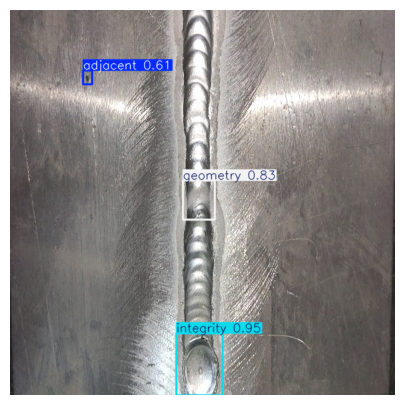

Found 1 objects in the image.
  - Defect: integrity
    Confidence: 0.27
    Coordinates: [363.5704345703125, 262.59991455078125, 439.95068359375, 362.63958740234375]


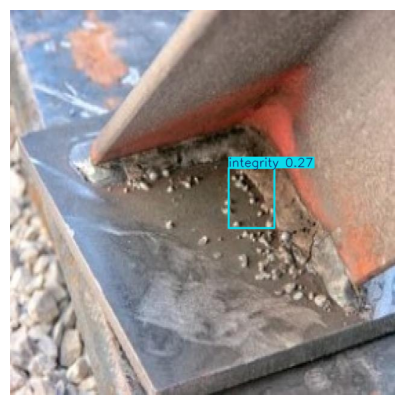

Found 3 objects in the image.
  - Defect: geometry
    Confidence: 0.85
    Coordinates: [300.1192932128906, 290.7318115234375, 361.3989562988281, 377.34033203125]
  - Defect: adjacent
    Confidence: 0.62
    Coordinates: [133.17251586914062, 485.83636474609375, 151.28274536132812, 516.6604614257812]
  - Defect: geometry
    Confidence: 0.36
    Coordinates: [295.7922058105469, 0.07918930053710938, 341.9617614746094, 20.004688262939453]


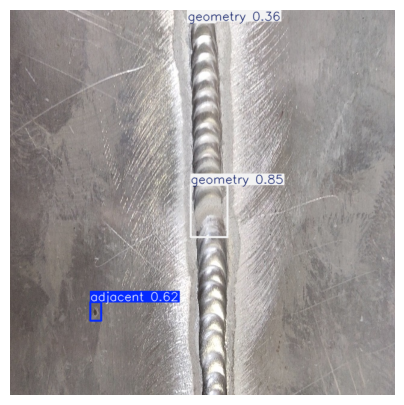

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.77
    Coordinates: [337.009033203125, 279.41680908203125, 360.6761474609375, 298.0611572265625]
  - Defect: integrity
    Confidence: 0.44
    Coordinates: [311.81622314453125, 275.60650634765625, 320.87408447265625, 288.73785400390625]


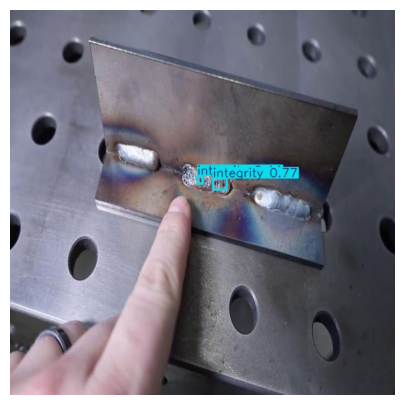

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.81
    Coordinates: [268.7588195800781, 472.50811767578125, 326.3425598144531, 557.4888305664062]


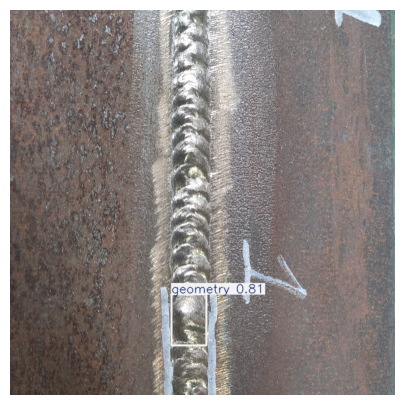

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.95
    Coordinates: [313.86676025390625, 253.35829162597656, 394.04998779296875, 341.0382080078125]
  - Defect: integrity
    Confidence: 0.77
    Coordinates: [248.87144470214844, 346.5771484375, 289.23193359375, 380.7359619140625]


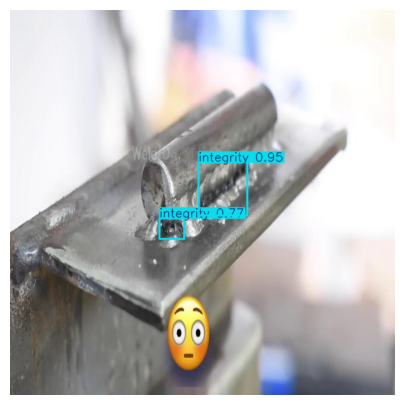

Found 12 objects in the image.
  - Defect: postprocessing
    Confidence: 0.80
    Coordinates: [382.56951904296875, 376.0191345214844, 405.33502197265625, 396.8049621582031]
  - Defect: adjacent
    Confidence: 0.78
    Coordinates: [0.059680938720703125, 374.28936767578125, 34.22194290161133, 399.344970703125]
  - Defect: postprocessing
    Confidence: 0.75
    Coordinates: [211.85830688476562, 383.8294372558594, 240.43399047851562, 404.5035095214844]
  - Defect: adjacent
    Confidence: 0.73
    Coordinates: [110.75593566894531, 361.717529296875, 135.34922790527344, 377.822021484375]
  - Defect: adjacent
    Confidence: 0.73
    Coordinates: [65.03096008300781, 593.7454833984375, 81.62416076660156, 610.9642333984375]
  - Defect: integrity
    Confidence: 0.70
    Coordinates: [425.2371826171875, 316.79376220703125, 445.934814453125, 339.33416748046875]
  - Defect: adjacent
    Confidence: 0.62
    Coordinates: [553.903076171875, 376.21014404296875, 575.51806640625, 396.1509399414062

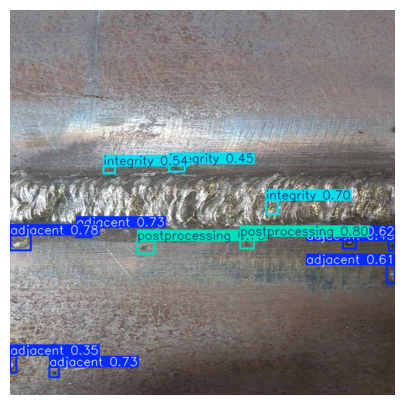

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.58
    Coordinates: [278.4461669921875, 37.16246032714844, 440.6217041015625, 145.66958618164062]


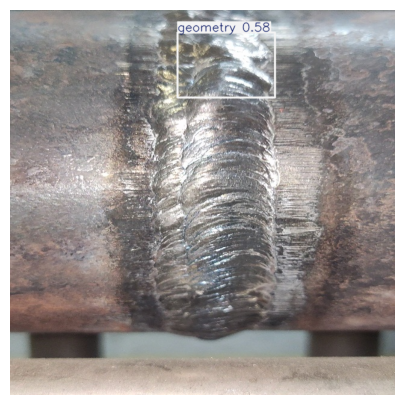

Found 4 objects in the image.
  - Defect: adjacent
    Confidence: 0.94
    Coordinates: [171.39962768554688, 116.06179809570312, 257.8998107910156, 312.48663330078125]
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [282.5688171386719, 269.16754150390625, 365.0980529785156, 368.6142578125]
  - Defect: adjacent
    Confidence: 0.84
    Coordinates: [173.50782775878906, 576.18896484375, 221.7551727294922, 640.0]
  - Defect: nonfulfillment
    Confidence: 0.29
    Coordinates: [286.7635498046875, 0.0, 378.1109619140625, 24.965015411376953]


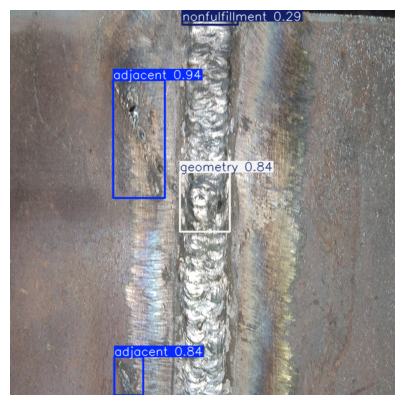

Found 6 objects in the image.
  - Defect: adjacent
    Confidence: 0.73
    Coordinates: [239.10000610351562, 131.0198974609375, 261.21795654296875, 183.49871826171875]
  - Defect: adjacent
    Confidence: 0.68
    Coordinates: [133.64376831054688, 48.63352966308594, 148.70150756835938, 76.46539306640625]
  - Defect: adjacent
    Confidence: 0.66
    Coordinates: [261.25872802734375, 251.5341339111328, 275.56903076171875, 281.78521728515625]
  - Defect: adjacent
    Confidence: 0.62
    Coordinates: [238.63717651367188, 86.84149169921875, 253.24252319335938, 109.65118408203125]
  - Defect: adjacent
    Confidence: 0.52
    Coordinates: [503.9346923828125, 235.49607849121094, 525.978515625, 310.6939697265625]
  - Defect: adjacent
    Confidence: 0.44
    Coordinates: [236.36285400390625, 356.372802734375, 250.5439453125, 386.6842041015625]


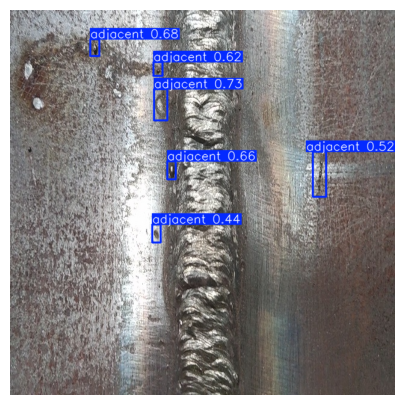

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.82
    Coordinates: [277.3011474609375, 70.81938171386719, 333.22613525390625, 142.2257537841797]


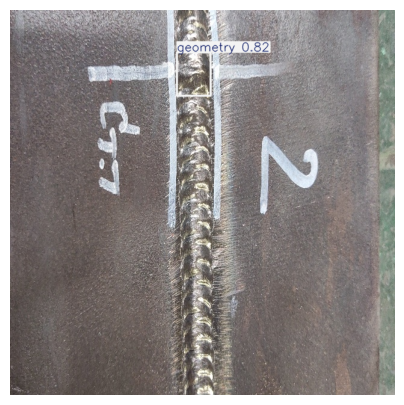

Found 3 objects in the image.
  - Defect: nonfulfillment
    Confidence: 0.87
    Coordinates: [443.64825439453125, 257.3143310546875, 611.2706909179688, 387.72210693359375]
  - Defect: nonfulfillment
    Confidence: 0.81
    Coordinates: [402.2105712890625, 242.2515869140625, 448.0665283203125, 371.64337158203125]
  - Defect: integrity
    Confidence: 0.75
    Coordinates: [372.5833740234375, 266.94091796875, 390.6678466796875, 293.2825927734375]


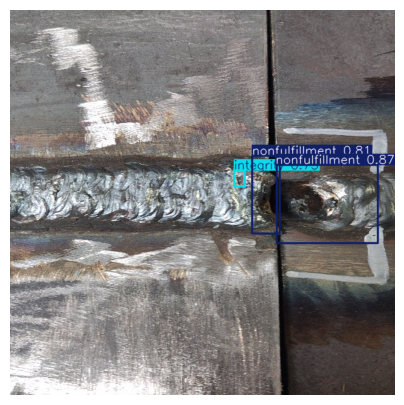

Found 3 objects in the image.
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [120.80028533935547, 274.24951171875, 188.46075439453125, 355.9151611328125]
  - Defect: integrity
    Confidence: 0.80
    Coordinates: [442.181396484375, 268.121826171875, 522.4886474609375, 288.720947265625]
  - Defect: geometry
    Confidence: 0.78
    Coordinates: [608.1708984375, 269.9278869628906, 640.0, 314.0963439941406]


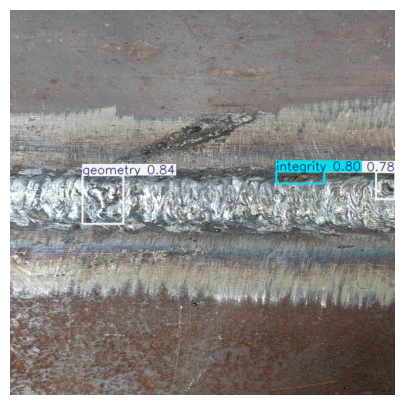

Found 4 objects in the image.
  - Defect: integrity
    Confidence: 0.65
    Coordinates: [136.32171630859375, 237.21902465820312, 615.5587158203125, 335.0370178222656]
  - Defect: integrity
    Confidence: 0.63
    Coordinates: [40.3994140625, 236.56982421875, 519.5729370117188, 333.5546875]
  - Defect: integrity
    Confidence: 0.33
    Coordinates: [113.87139892578125, 556.661865234375, 252.23593139648438, 615.549560546875]
  - Defect: integrity
    Confidence: 0.32
    Coordinates: [168.04788208007812, 557.798828125, 251.94033813476562, 614.038330078125]


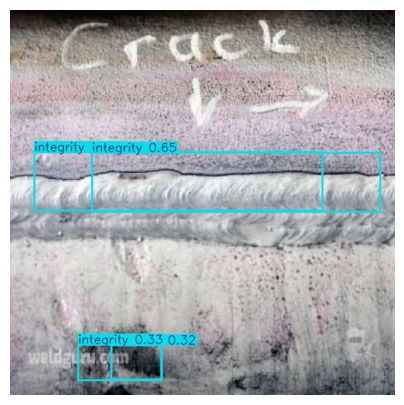

Found 3 objects in the image.
  - Defect: geometry
    Confidence: 0.80
    Coordinates: [230.09031677246094, 384.5946044921875, 412.91357421875, 446.6251220703125]
  - Defect: postprocessing
    Confidence: 0.79
    Coordinates: [428.32452392578125, 383.17791748046875, 499.0372314453125, 422.11676025390625]
  - Defect: geometry
    Confidence: 0.71
    Coordinates: [248.63768005371094, 85.99613952636719, 410.705322265625, 136.44676208496094]


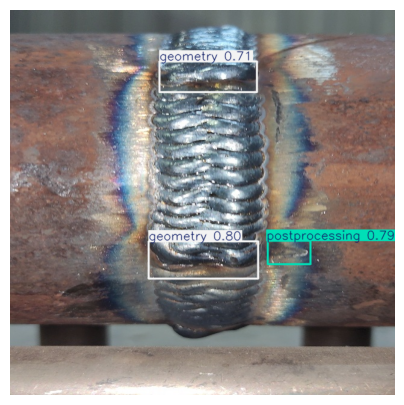

Found 10 objects in the image.
  - Defect: adjacent
    Confidence: 0.84
    Coordinates: [62.729087829589844, 165.58050537109375, 110.71082305908203, 197.8543701171875]
  - Defect: geometry
    Confidence: 0.81
    Coordinates: [385.8443298339844, 263.17327880859375, 487.4059753417969, 338.09051513671875]
  - Defect: adjacent
    Confidence: 0.80
    Coordinates: [508.46929931640625, 368.60321044921875, 578.1603393554688, 389.79302978515625]
  - Defect: postprocessing
    Confidence: 0.77
    Coordinates: [532.3131103515625, 220.38320922851562, 587.3050537109375, 253.84170532226562]
  - Defect: postprocessing
    Confidence: 0.75
    Coordinates: [473.74273681640625, 234.94180297851562, 510.20794677734375, 258.191162109375]
  - Defect: adjacent
    Confidence: 0.69
    Coordinates: [40.90541076660156, 400.45013427734375, 97.71820068359375, 437.19207763671875]
  - Defect: adjacent
    Confidence: 0.68
    Coordinates: [66.48808288574219, 367.69134521484375, 94.43473815917969, 390.32073

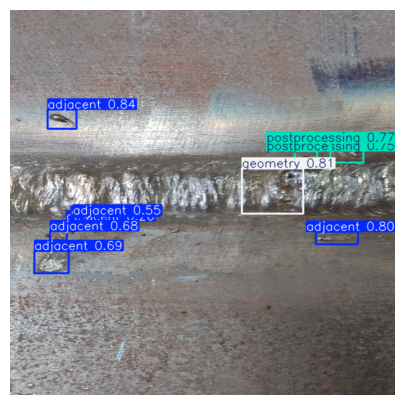

Found 10 objects in the image.
  - Defect: adjacent
    Confidence: 0.85
    Coordinates: [394.514892578125, 330.27496337890625, 438.17236328125, 416.7139892578125]
  - Defect: postprocessing
    Confidence: 0.74
    Coordinates: [183.59127807617188, 265.55084228515625, 206.26028442382812, 296.32659912109375]
  - Defect: adjacent
    Confidence: 0.73
    Coordinates: [422.669677734375, 431.7526550292969, 439.9862060546875, 482.2290954589844]
  - Defect: integrity
    Confidence: 0.72
    Coordinates: [277.39227294921875, 243.42300415039062, 352.93511962890625, 277.6800231933594]
  - Defect: adjacent
    Confidence: 0.71
    Coordinates: [118.45654296875, 413.54156494140625, 133.27859497070312, 442.06707763671875]
  - Defect: integrity
    Confidence: 0.69
    Coordinates: [289.3272705078125, 203.02597045898438, 338.8304443359375, 230.81954956054688]
  - Defect: adjacent
    Confidence: 0.64
    Coordinates: [194.79971313476562, 510.87274169921875, 210.42941284179688, 594.2313842773438]

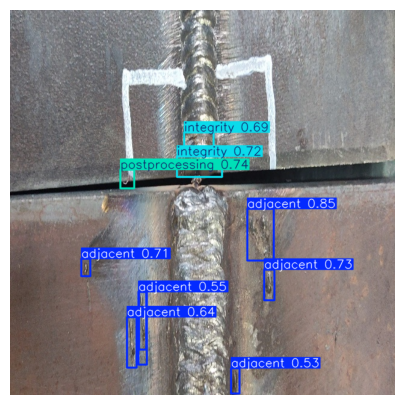

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.72
    Coordinates: [401.2938232421875, 212.29615783691406, 426.5513916015625, 425.9278564453125]
  - Defect: integrity
    Confidence: 0.33
    Coordinates: [397.76751708984375, 212.40480041503906, 420.41302490234375, 422.8138427734375]


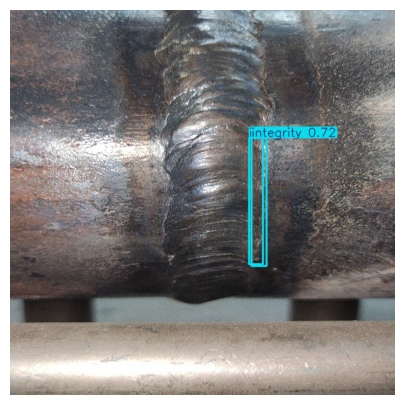

Found 0 objects in the image.


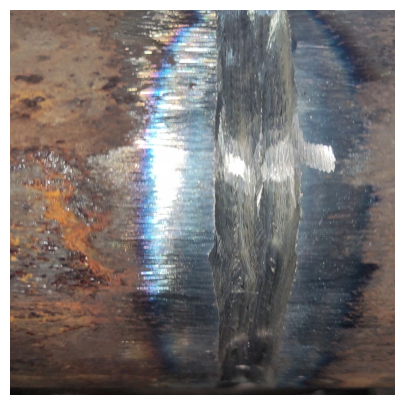

Found 8 objects in the image.
  - Defect: adjacent
    Confidence: 0.80
    Coordinates: [254.65472412109375, 173.14166259765625, 296.08929443359375, 196.52798461914062]
  - Defect: geometry
    Confidence: 0.80
    Coordinates: [52.49684143066406, 278.7733459472656, 110.82917785644531, 367.3431091308594]
  - Defect: integrity
    Confidence: 0.80
    Coordinates: [454.32122802734375, 334.1894226074219, 498.22943115234375, 372.8240051269531]
  - Defect: nonfulfillment
    Confidence: 0.75
    Coordinates: [573.4537353515625, 263.44488525390625, 596.9365234375, 402.38311767578125]
  - Defect: adjacent
    Confidence: 0.73
    Coordinates: [239.67477416992188, 263.86187744140625, 262.24652099609375, 284.37530517578125]
  - Defect: adjacent
    Confidence: 0.71
    Coordinates: [204.61819458007812, 190.44488525390625, 241.07327270507812, 212.33392333984375]
  - Defect: adjacent
    Confidence: 0.70
    Coordinates: [161.417724609375, 217.60179138183594, 180.11117553710938, 237.19990539550

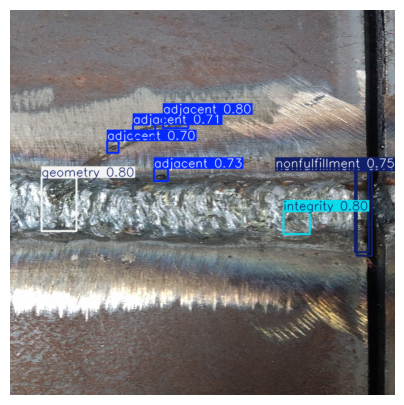

Found 5 objects in the image.
  - Defect: nonfulfillment
    Confidence: 0.90
    Coordinates: [274.9787902832031, 275.40081787109375, 356.8810729980469, 306.35052490234375]
  - Defect: geometry
    Confidence: 0.88
    Coordinates: [281.62481689453125, 306.42236328125, 353.85418701171875, 388.7501220703125]
  - Defect: geometry
    Confidence: 0.78
    Coordinates: [276.879150390625, 223.8972930908203, 355.10888671875, 299.05255126953125]
  - Defect: integrity
    Confidence: 0.66
    Coordinates: [306.88677978515625, 30.815593719482422, 334.45452880859375, 63.24672317504883]
  - Defect: integrity
    Confidence: 0.64
    Coordinates: [306.42529296875, 156.62799072265625, 339.0653076171875, 195.23077392578125]


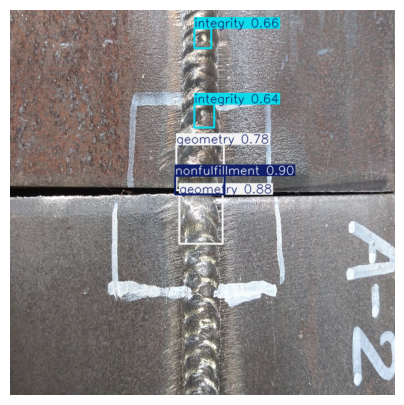

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.52
    Coordinates: [273.094970703125, 430.3924560546875, 315.20947265625, 486.7818603515625]
  - Defect: geometry
    Confidence: 0.52
    Coordinates: [271.68511962890625, 432.28009033203125, 317.34234619140625, 489.29254150390625]


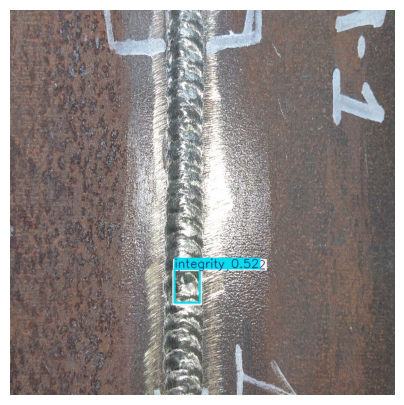

Found 0 objects in the image.


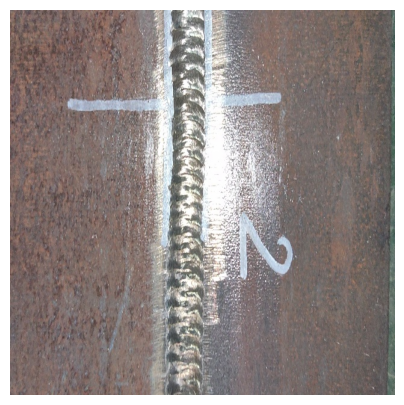

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.73
    Coordinates: [295.9688720703125, 474.50372314453125, 422.5167236328125, 524.4104614257812]


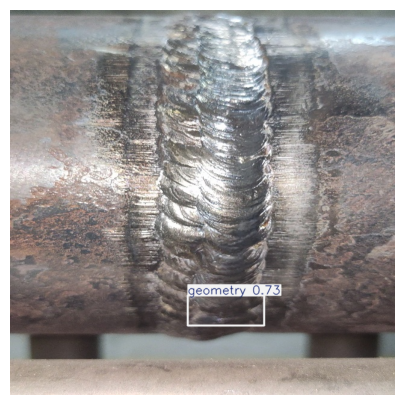

Found 4 objects in the image.
  - Defect: nonfulfillment
    Confidence: 0.81
    Coordinates: [78.72836303710938, 250.67803955078125, 104.95669555664062, 373.58056640625]
  - Defect: integrity
    Confidence: 0.78
    Coordinates: [91.27981567382812, 288.0195617675781, 115.71124267578125, 312.8092346191406]
  - Defect: geometry
    Confidence: 0.77
    Coordinates: [33.22333526611328, 287.29931640625, 77.32637023925781, 388.581298828125]
  - Defect: geometry
    Confidence: 0.74
    Coordinates: [83.65921020507812, 252.54220581054688, 123.114013671875, 371.6180114746094]


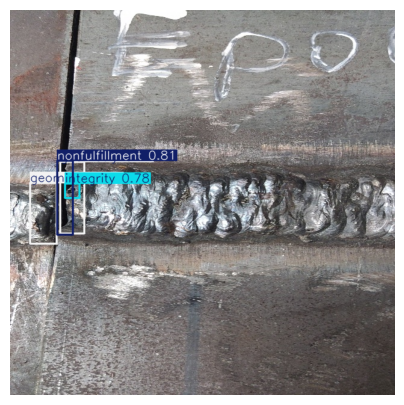

Found 5 objects in the image.
  - Defect: integrity
    Confidence: 0.78
    Coordinates: [353.53619384765625, 540.75244140625, 379.44378662109375, 590.67333984375]
  - Defect: adjacent
    Confidence: 0.72
    Coordinates: [468.3407287597656, 118.21707153320312, 511.6804504394531, 255.25881958007812]
  - Defect: adjacent
    Confidence: 0.68
    Coordinates: [383.2060852050781, 178.80316162109375, 398.5663757324219, 211.86959838867188]
  - Defect: adjacent
    Confidence: 0.64
    Coordinates: [442.8587341308594, 78.92051696777344, 462.6496887207031, 109.67802429199219]
  - Defect: nonfulfillment
    Confidence: 0.64
    Coordinates: [264.96038818359375, 592.9032592773438, 389.67840576171875, 639.8336791992188]


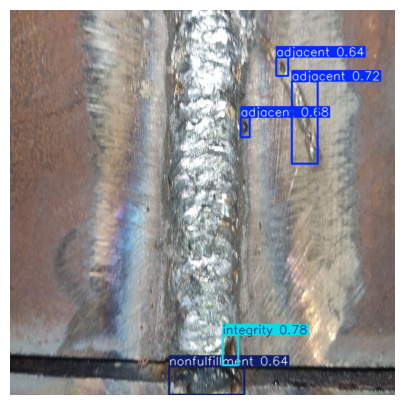

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.57
    Coordinates: [16.759662628173828, 144.1739959716797, 138.39466857910156, 209.7497100830078]
  - Defect: integrity
    Confidence: 0.46
    Coordinates: [350.52825927734375, 231.28895568847656, 640.0, 344.765869140625]


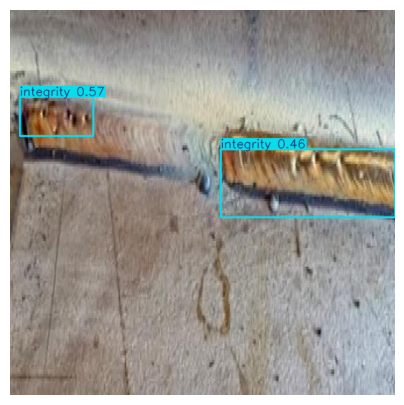

Found 2 objects in the image.
  - Defect: geometry
    Confidence: 0.80
    Coordinates: [254.17071533203125, 198.6187744140625, 454.46881103515625, 319.9129638671875]
  - Defect: geometry
    Confidence: 0.51
    Coordinates: [253.252685546875, 401.5383605957031, 323.3448486328125, 467.5727844238281]


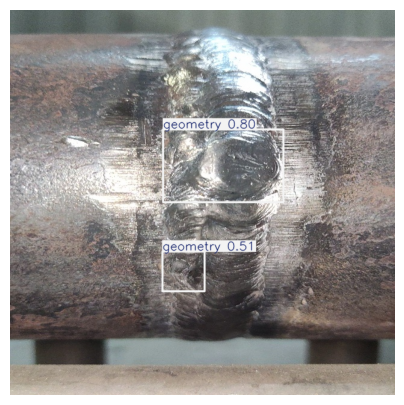

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.52
    Coordinates: [8.73321533203125, 147.02549743652344, 487.05474853515625, 219.6266632080078]
  - Defect: integrity
    Confidence: 0.46
    Coordinates: [136.21144104003906, 145.81024169921875, 615.56640625, 244.03970336914062]


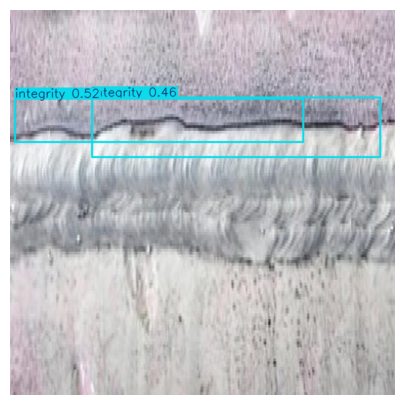

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.80
    Coordinates: [290.1297302246094, 8.991928100585938, 347.2658996582031, 90.9027099609375]


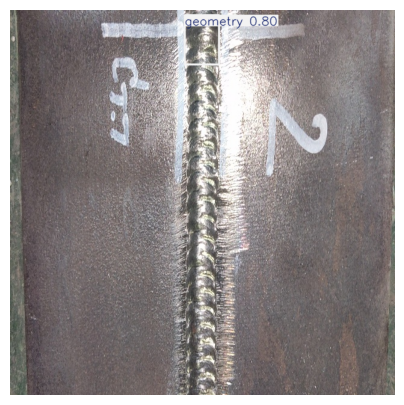

Found 0 objects in the image.


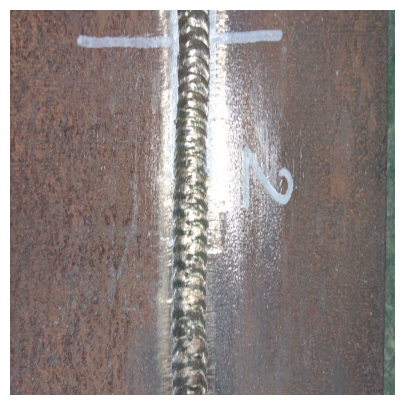

Found 3 objects in the image.
  - Defect: integrity
    Confidence: 0.67
    Coordinates: [0.0, 334.88092041015625, 145.43902587890625, 394.01727294921875]
  - Defect: integrity
    Confidence: 0.61
    Coordinates: [361.6783447265625, 321.5677490234375, 571.05322265625, 388.321533203125]
  - Defect: integrity
    Confidence: 0.42
    Coordinates: [0.0, 303.8538818359375, 145.5104217529297, 396.52215576171875]


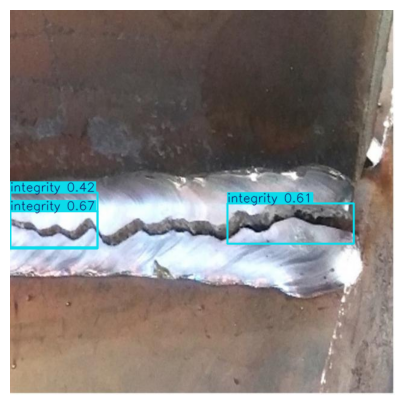

Found 4 objects in the image.
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [279.3568115234375, 120.10540771484375, 363.763427734375, 208.28912353515625]
  - Defect: adjacent
    Confidence: 0.82
    Coordinates: [173.5117645263672, 0.0, 255.3485565185547, 150.92214965820312]
  - Defect: adjacent
    Confidence: 0.81
    Coordinates: [179.8592529296875, 407.00830078125, 237.44320678710938, 640.0]
  - Defect: geometry
    Confidence: 0.45
    Coordinates: [270.81280517578125, 348.747802734375, 292.87738037109375, 563.7515258789062]


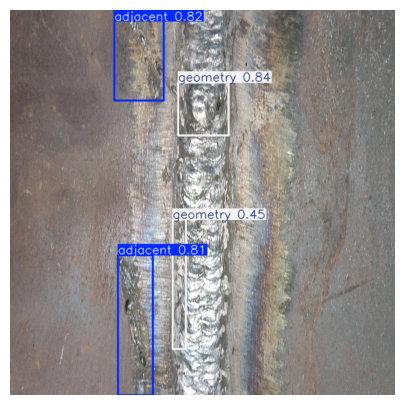

Found 6 objects in the image.
  - Defect: adjacent
    Confidence: 0.69
    Coordinates: [133.56602478027344, 175.72958374023438, 149.57887268066406, 209.05410766601562]
  - Defect: adjacent
    Confidence: 0.68
    Coordinates: [238.84097290039062, 258.0048828125, 260.1804504394531, 310.325927734375]
  - Defect: adjacent
    Confidence: 0.66
    Coordinates: [260.7471923828125, 377.36907958984375, 275.4093017578125, 406.58880615234375]
  - Defect: adjacent
    Confidence: 0.65
    Coordinates: [237.35714721679688, 215.65028381347656, 252.05831909179688, 239.87501525878906]
  - Defect: adjacent
    Confidence: 0.61
    Coordinates: [502.954833984375, 357.2325439453125, 519.9287109375, 433.6944580078125]
  - Defect: adjacent
    Confidence: 0.49
    Coordinates: [236.31100463867188, 483.5848388671875, 250.79156494140625, 514.3361206054688]


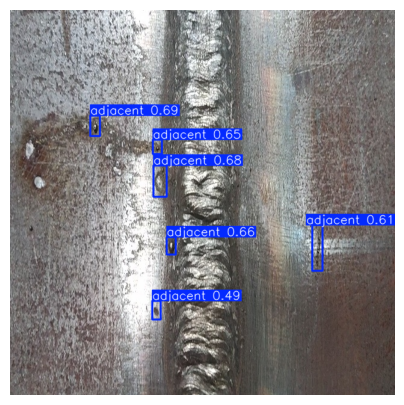

Found 0 objects in the image.


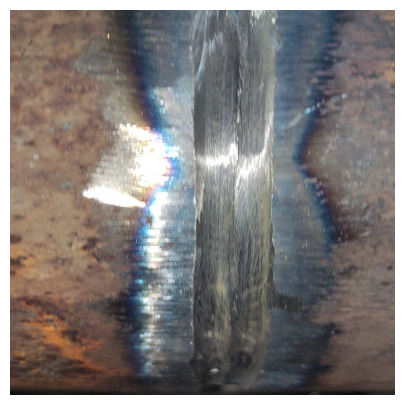

Found 6 objects in the image.
  - Defect: geometry
    Confidence: 0.83
    Coordinates: [322.07177734375, 268.34478759765625, 386.240234375, 358.74884033203125]
  - Defect: integrity
    Confidence: 0.73
    Coordinates: [512.802978515625, 258.58709716796875, 547.0379638671875, 283.27142333984375]
  - Defect: adjacent
    Confidence: 0.71
    Coordinates: [99.27609252929688, 219.9814453125, 131.3632354736328, 245.20211791992188]
  - Defect: adjacent
    Confidence: 0.65
    Coordinates: [135.34719848632812, 137.677001953125, 155.95626831054688, 157.37200927734375]
  - Defect: nonfulfillment
    Confidence: 0.60
    Coordinates: [88.7349853515625, 256.53179931640625, 113.74099731445312, 371.69256591796875]
  - Defect: nonfulfillment
    Confidence: 0.51
    Coordinates: [45.83695602416992, 246.1990509033203, 87.44248962402344, 384.09320068359375]


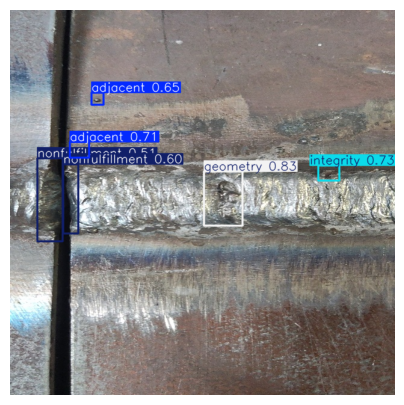

Found 0 objects in the image.


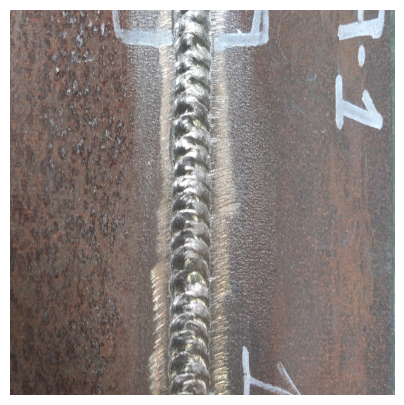

Found 0 objects in the image.


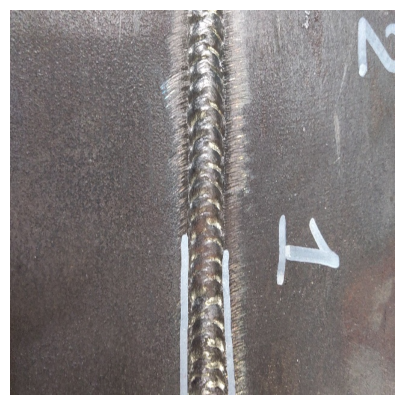

Found 1 objects in the image.
  - Defect: integrity
    Confidence: 0.75
    Coordinates: [40.1534423828125, 239.87811279296875, 519.7401123046875, 328.05596923828125]


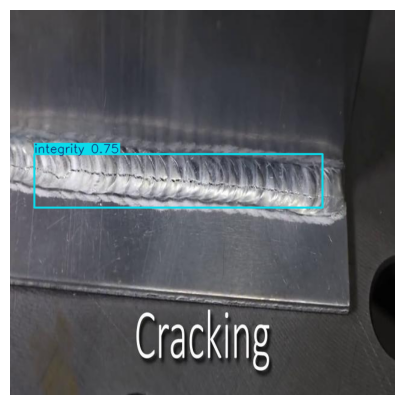

Found 3 objects in the image.
  - Defect: adjacent
    Confidence: 0.70
    Coordinates: [450.2989501953125, 296.0579528808594, 472.6756591796875, 331.4175109863281]
  - Defect: postprocessing
    Confidence: 0.70
    Coordinates: [197.3186798095703, 237.921875, 234.99375915527344, 259.3021240234375]
  - Defect: adjacent
    Confidence: 0.64
    Coordinates: [438.667236328125, 419.34552001953125, 457.3912353515625, 451.12591552734375]


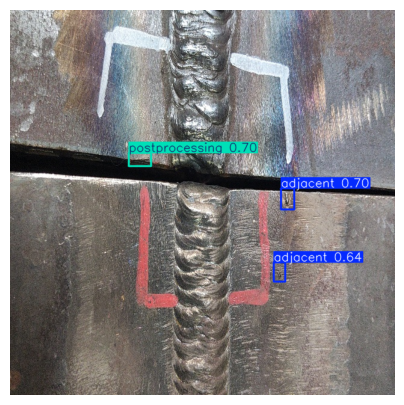

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.81
    Coordinates: [274.84051513671875, 93.73262023925781, 338.28009033203125, 174.98509216308594]


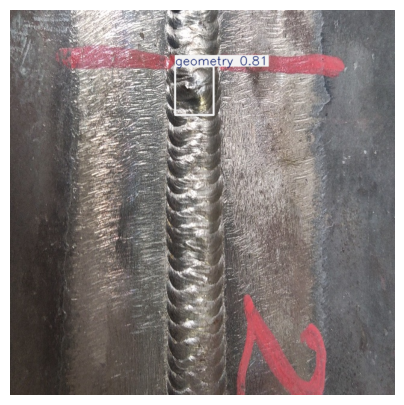

Found 7 objects in the image.
  - Defect: geometry
    Confidence: 0.83
    Coordinates: [275.781005859375, 0.2543792724609375, 362.49658203125, 108.62405395507812]
  - Defect: adjacent
    Confidence: 0.80
    Coordinates: [386.9877624511719, 61.53864288330078, 417.3913269042969, 117.26136016845703]
  - Defect: adjacent
    Confidence: 0.72
    Coordinates: [188.7825927734375, 81.9241943359375, 203.209228515625, 115.91595458984375]
  - Defect: adjacent
    Confidence: 0.72
    Coordinates: [106.73421478271484, 106.91426086425781, 122.16674041748047, 133.75672912597656]
  - Defect: adjacent
    Confidence: 0.65
    Coordinates: [367.49334716796875, 227.20327758789062, 382.61639404296875, 291.8393249511719]
  - Defect: adjacent
    Confidence: 0.64
    Coordinates: [394.1219787597656, 232.6776123046875, 409.7247619628906, 262.9815673828125]
  - Defect: adjacent
    Confidence: 0.49
    Coordinates: [500.0732421875, 93.5126953125, 512.001220703125, 112.92166137695312]


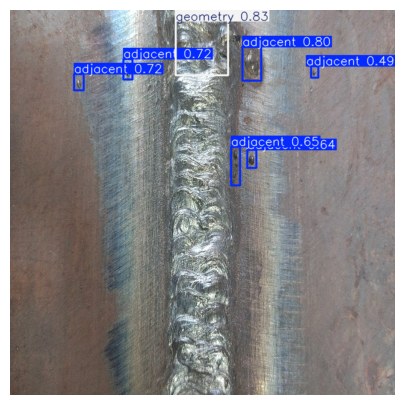

Found 3 objects in the image.
  - Defect: integrity
    Confidence: 0.63
    Coordinates: [434.15875244140625, 579.844970703125, 505.55657958984375, 639.699951171875]
  - Defect: integrity
    Confidence: 0.52
    Coordinates: [251.06390380859375, 464.2071533203125, 280.178466796875, 495.63214111328125]
  - Defect: integrity
    Confidence: 0.49
    Coordinates: [228.19052124023438, 401.9063720703125, 257.2533874511719, 440.4564208984375]


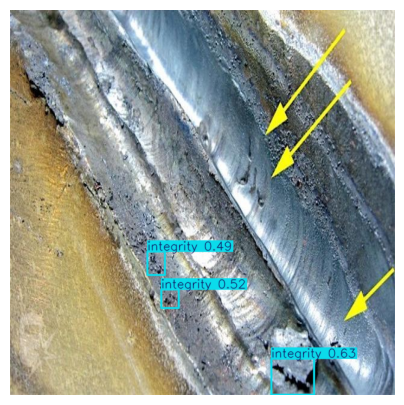

Found 0 objects in the image.


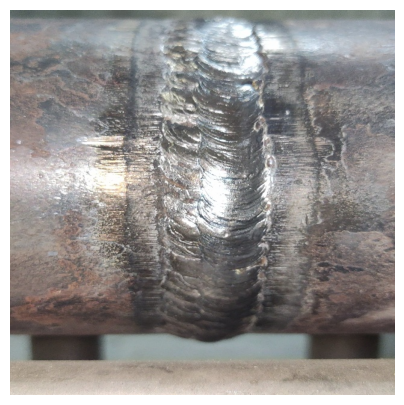

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.62
    Coordinates: [236.55845642089844, 3.1788482666015625, 408.4764404296875, 61.842796325683594]


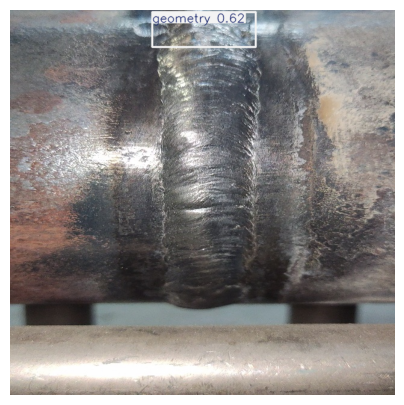

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.82
    Coordinates: [256.577880859375, 265.0526123046875, 426.2059326171875, 388.06884765625]


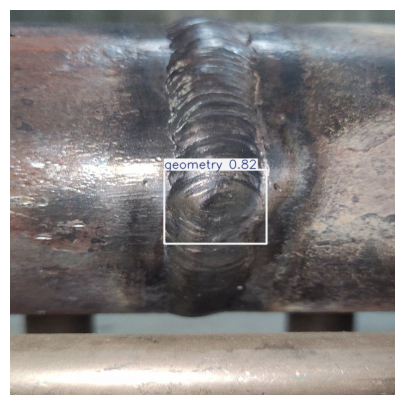

Found 31 objects in the image.
  - Defect: integrity
    Confidence: 0.86
    Coordinates: [121.96250915527344, 187.45538330078125, 152.52378845214844, 230.31784057617188]
  - Defect: integrity
    Confidence: 0.78
    Coordinates: [306.36309814453125, 181.21302795410156, 339.02960205078125, 228.4192352294922]
  - Defect: integrity
    Confidence: 0.76
    Coordinates: [365.3575134277344, 164.02586364746094, 419.4145202636719, 220.80262756347656]
  - Defect: integrity
    Confidence: 0.75
    Coordinates: [425.9952392578125, 167.59274291992188, 467.5167236328125, 237.41915893554688]
  - Defect: integrity
    Confidence: 0.73
    Coordinates: [141.57156372070312, 348.14501953125, 171.48605346679688, 411.506103515625]
  - Defect: integrity
    Confidence: 0.73
    Coordinates: [232.37872314453125, 312.9464111328125, 255.41470336914062, 357.8427734375]
  - Defect: integrity
    Confidence: 0.72
    Coordinates: [194.8563690185547, 291.83489990234375, 220.93199157714844, 339.55633544921875

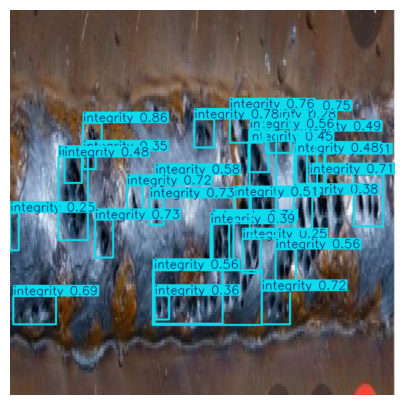

Found 3 objects in the image.
  - Defect: geometry
    Confidence: 0.88
    Coordinates: [245.77667236328125, 290.66400146484375, 348.14166259765625, 392.65081787109375]
  - Defect: geometry
    Confidence: 0.85
    Coordinates: [251.45521545410156, 46.40647888183594, 341.961669921875, 190.54440307617188]
  - Defect: adjacent
    Confidence: 0.69
    Coordinates: [353.8616943359375, 48.26084899902344, 369.191650390625, 95.20259094238281]


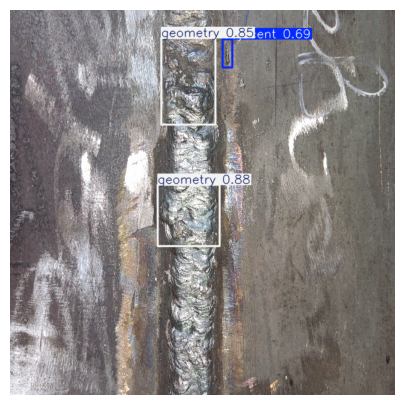

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.73
    Coordinates: [25.85394287109375, 261.19952392578125, 501.873046875, 374.83404541015625]
  - Defect: adjacent
    Confidence: 0.38
    Coordinates: [254.9463653564453, 586.0448608398438, 292.94171142578125, 629.4419555664062]


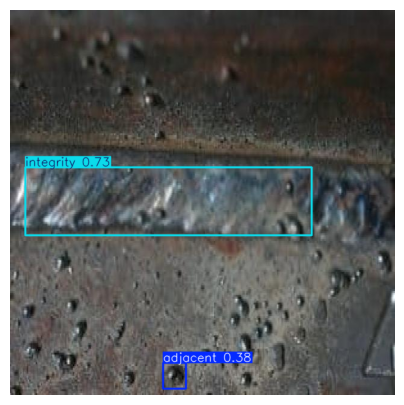

Found 1 objects in the image.
  - Defect: integrity
    Confidence: 0.52
    Coordinates: [255.34210205078125, 484.144287109375, 304.6600341796875, 548.0367431640625]


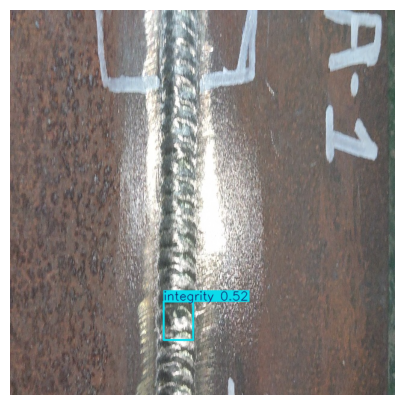

Found 5 objects in the image.
  - Defect: geometry
    Confidence: 0.86
    Coordinates: [282.701416015625, 411.5565185546875, 330.5096435546875, 491.3673095703125]
  - Defect: integrity
    Confidence: 0.86
    Coordinates: [281.8064880371094, 153.46359252929688, 331.1264343261719, 226.66397094726562]
  - Defect: postprocessing
    Confidence: 0.67
    Coordinates: [538.7161865234375, 141.21585083007812, 555.5802001953125, 155.47348022460938]
  - Defect: postprocessing
    Confidence: 0.64
    Coordinates: [488.75701904296875, 116.23677062988281, 505.03643798828125, 135.4063720703125]
  - Defect: postprocessing
    Confidence: 0.61
    Coordinates: [587.491943359375, 138.623046875, 605.12890625, 154.40338134765625]


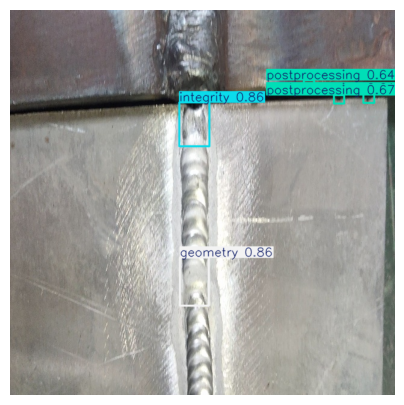

Found 3 objects in the image.
  - Defect: postprocessing
    Confidence: 0.79
    Coordinates: [424.322265625, 397.35003662109375, 498.81451416015625, 437.96917724609375]
  - Defect: geometry
    Confidence: 0.69
    Coordinates: [233.7870635986328, 409.9198303222656, 413.09613037109375, 456.2932434082031]
  - Defect: geometry
    Confidence: 0.66
    Coordinates: [244.1482696533203, 111.84176635742188, 412.12774658203125, 147.98104858398438]


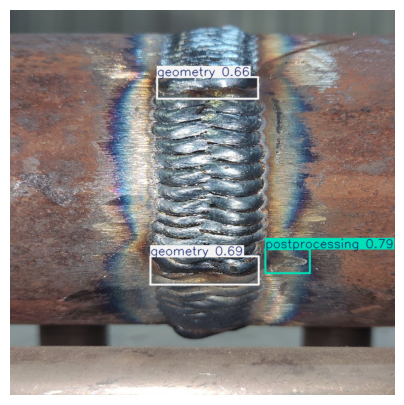

Found 6 objects in the image.
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [284.31829833984375, 333.5706787109375, 372.39129638671875, 492.574951171875]
  - Defect: adjacent
    Confidence: 0.83
    Coordinates: [399.13153076171875, 444.91949462890625, 430.51226806640625, 507.21380615234375]
  - Defect: adjacent
    Confidence: 0.70
    Coordinates: [184.02767944335938, 474.10015869140625, 200.46182250976562, 511.44342041015625]
  - Defect: adjacent
    Confidence: 0.69
    Coordinates: [95.72410583496094, 504.419677734375, 111.04425048828125, 531.2939453125]
  - Defect: adjacent
    Confidence: 0.66
    Coordinates: [163.28237915039062, 150.61196899414062, 184.17105102539062, 202.96585083007812]
  - Defect: adjacent
    Confidence: 0.66
    Coordinates: [522.5383911132812, 477.514892578125, 536.5952758789062, 500.92584228515625]


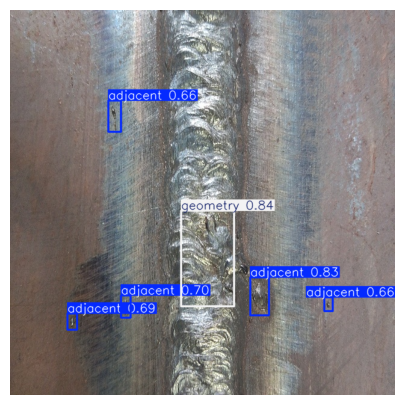

Found 3 objects in the image.
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [283.50604248046875, 390.974853515625, 336.98553466796875, 454.78076171875]
  - Defect: geometry
    Confidence: 0.82
    Coordinates: [276.704833984375, 37.16184997558594, 330.826904296875, 132.12217712402344]
  - Defect: adjacent
    Confidence: 0.62
    Coordinates: [127.00474548339844, 541.24267578125, 145.5764617919922, 573.309326171875]


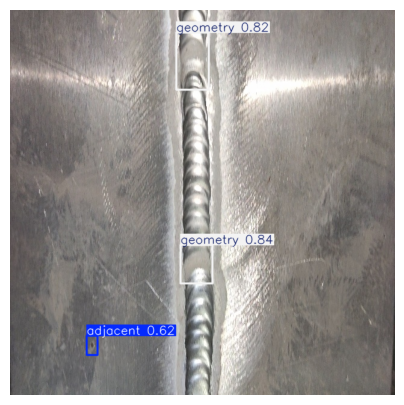

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.91
    Coordinates: [338.7781066894531, 316.45330810546875, 471.8455505371094, 386.56304931640625]
  - Defect: integrity
    Confidence: 0.83
    Coordinates: [219.34103393554688, 330.7611999511719, 305.2333068847656, 386.4100036621094]


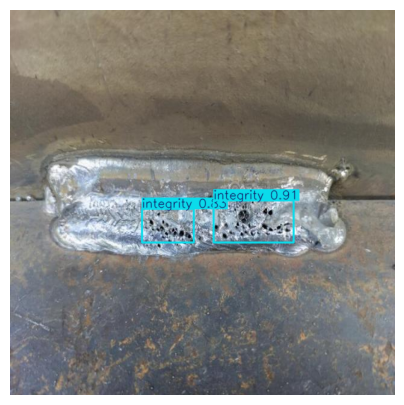

Found 11 objects in the image.
  - Defect: adjacent
    Confidence: 0.84
    Coordinates: [437.069091796875, 441.23223876953125, 546.4284057617188, 533.6997680664062]
  - Defect: geometry
    Confidence: 0.84
    Coordinates: [149.73641967773438, 283.30517578125, 195.95394897460938, 343.7100830078125]
  - Defect: adjacent
    Confidence: 0.82
    Coordinates: [477.69012451171875, 585.3367919921875, 521.9171142578125, 628.5904541015625]
  - Defect: adjacent
    Confidence: 0.81
    Coordinates: [533.4440307617188, 369.9940185546875, 570.4015502929688, 396.029541015625]
  - Defect: adjacent
    Confidence: 0.74
    Coordinates: [99.83238220214844, 551.78857421875, 139.0330047607422, 567.8089599609375]
  - Defect: adjacent
    Confidence: 0.74
    Coordinates: [0.23801803588867188, 230.40072631835938, 46.346458435058594, 245.36019897460938]
  - Defect: adjacent
    Confidence: 0.72
    Coordinates: [539.1481323242188, 571.3567504882812, 570.8569946289062, 609.2406616210938]
  - Defect: ad

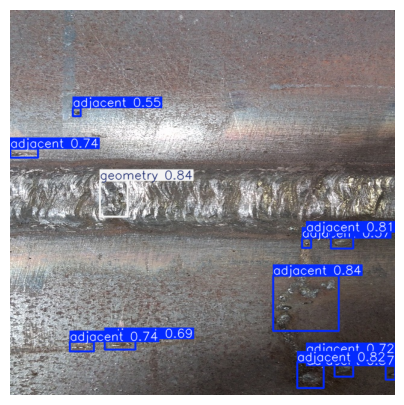

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.56
    Coordinates: [386.31829833984375, 300.25799560546875, 422.1236572265625, 431.4576416015625]
  - Defect: integrity
    Confidence: 0.53
    Coordinates: [119.07186889648438, 199.36923217773438, 346.5288391113281, 302.26043701171875]


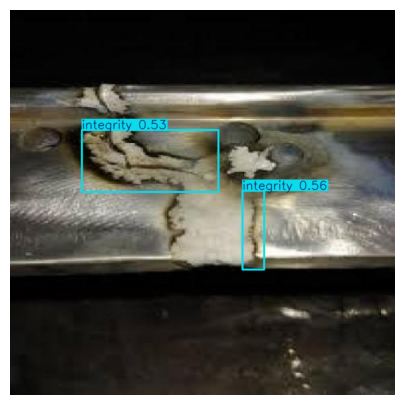

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.87
    Coordinates: [123.6084213256836, 266.04266357421875, 189.10537719726562, 388.37432861328125]


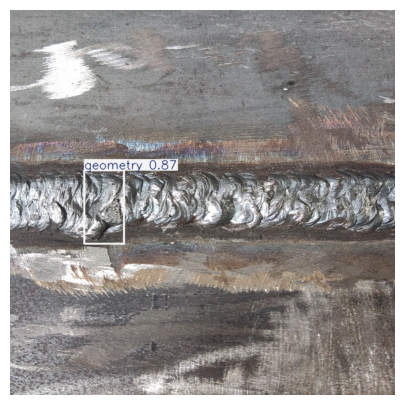

Found 2 objects in the image.
  - Defect: geometry
    Confidence: 0.75
    Coordinates: [267.43017578125, 304.37646484375, 375.4073486328125, 348.91650390625]
  - Defect: nonfulfillment
    Confidence: 0.62
    Coordinates: [284.43603515625, 344.5970153808594, 361.9791259765625, 383.1988220214844]


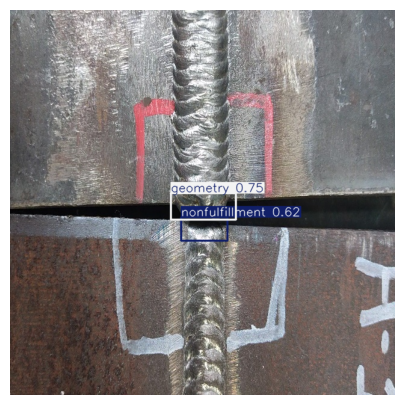

Found 5 objects in the image.
  - Defect: geometry
    Confidence: 0.85
    Coordinates: [254.93374633789062, 258.458984375, 307.2658386230469, 343.1956787109375]
  - Defect: geometry
    Confidence: 0.81
    Coordinates: [258.25823974609375, 582.5323486328125, 317.31048583984375, 639.9356689453125]
  - Defect: integrity
    Confidence: 0.75
    Coordinates: [259.0496826171875, 0.8078689575195312, 306.70831298828125, 66.7103500366211]
  - Defect: postprocessing
    Confidence: 0.63
    Coordinates: [587.2164306640625, 0.5811424255371094, 604.0767822265625, 14.765083312988281]
  - Defect: postprocessing
    Confidence: 0.51
    Coordinates: [535.7869873046875, 0.0, 553.046875, 10.77157211303711]


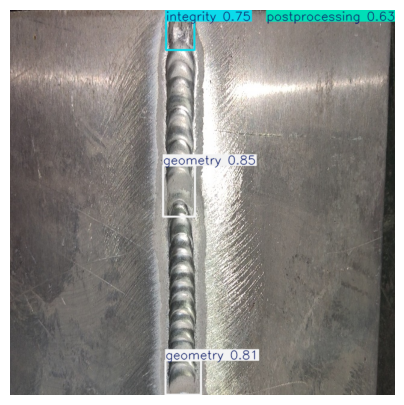

Found 1 objects in the image.
  - Defect: integrity
    Confidence: 0.91
    Coordinates: [211.60025024414062, 198.34158325195312, 393.0872497558594, 390.2917785644531]


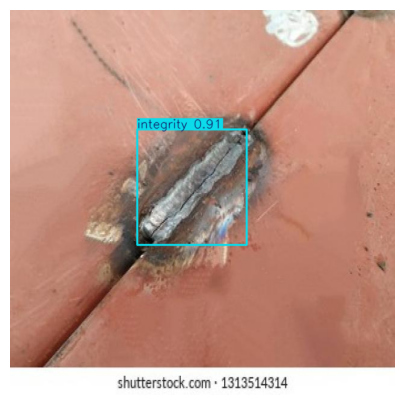

Found 3 objects in the image.
  - Defect: integrity
    Confidence: 0.69
    Coordinates: [120.44635009765625, 398.65753173828125, 597.9154052734375, 499.93572998046875]
  - Defect: integrity
    Confidence: 0.68
    Coordinates: [104.85224914550781, 527.498291015625, 583.1279907226562, 616.3837890625]
  - Defect: integrity
    Confidence: 0.59
    Coordinates: [56.81724548339844, 394.834228515625, 535.659423828125, 485.6424560546875]


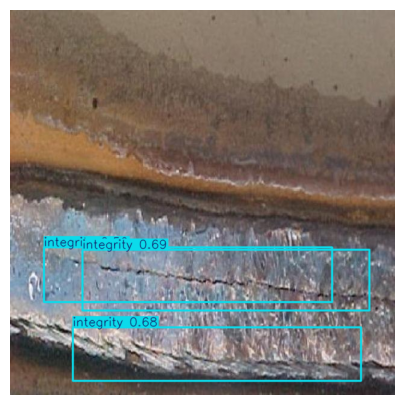

Found 8 objects in the image.
  - Defect: postprocessing
    Confidence: 0.77
    Coordinates: [80.15325927734375, 366.7749938964844, 104.17938232421875, 387.4729309082031]
  - Defect: adjacent
    Confidence: 0.70
    Coordinates: [314.5137939453125, 409.5557556152344, 359.83740234375, 441.0326843261719]
  - Defect: adjacent
    Confidence: 0.69
    Coordinates: [333.64306640625, 374.8692321777344, 359.5325927734375, 395.0885314941406]
  - Defect: adjacent
    Confidence: 0.68
    Coordinates: [368.5777587890625, 350.86279296875, 385.440185546875, 364.7764892578125]
  - Defect: adjacent
    Confidence: 0.66
    Coordinates: [324.9658508300781, 176.96517944335938, 374.8580017089844, 210.41610717773438]
  - Defect: postprocessing
    Confidence: 0.61
    Coordinates: [175.67355346679688, 224.08729553222656, 202.221435546875, 240.23707580566406]
  - Defect: adjacent
    Confidence: 0.49
    Coordinates: [247.48892211914062, 366.37176513671875, 269.5827941894531, 385.35546875]
  - Defect:

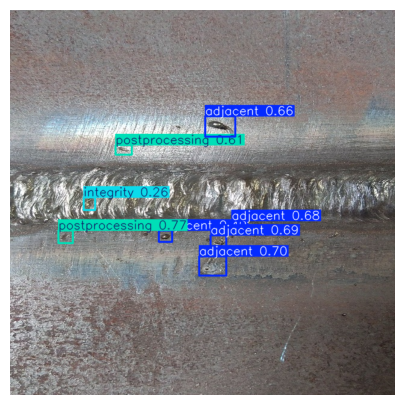

Found 2 objects in the image.
  - Defect: integrity
    Confidence: 0.93
    Coordinates: [295.4960021972656, 86.89894104003906, 372.0885925292969, 222.33213806152344]
  - Defect: nonfulfillment
    Confidence: 0.72
    Coordinates: [322.3569641113281, 209.4771728515625, 350.3335876464844, 368.1126708984375]


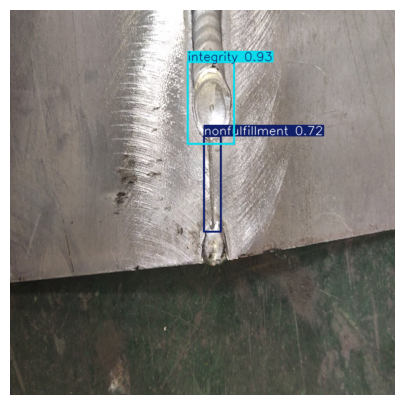

Found 8 objects in the image.
  - Defect: geometry
    Confidence: 0.81
    Coordinates: [278.89727783203125, 273.7171630859375, 316.74822998046875, 378.3785400390625]
  - Defect: adjacent
    Confidence: 0.72
    Coordinates: [521.8861083984375, 405.4674072265625, 536.2003173828125, 423.7000732421875]
  - Defect: adjacent
    Confidence: 0.70
    Coordinates: [167.1647491455078, 414.35711669921875, 190.59034729003906, 435.36492919921875]
  - Defect: adjacent
    Confidence: 0.65
    Coordinates: [141.62481689453125, 242.79574584960938, 155.08599853515625, 260.1078186035156]
  - Defect: adjacent
    Confidence: 0.61
    Coordinates: [515.7828369140625, 584.92041015625, 536.143798828125, 611.7388916015625]
  - Defect: adjacent
    Confidence: 0.45
    Coordinates: [534.5455322265625, 459.12994384765625, 547.1153564453125, 475.78973388671875]
  - Defect: adjacent
    Confidence: 0.32
    Coordinates: [615.294921875, 581.412841796875, 638.55078125, 611.0347900390625]
  - Defect: adjacent


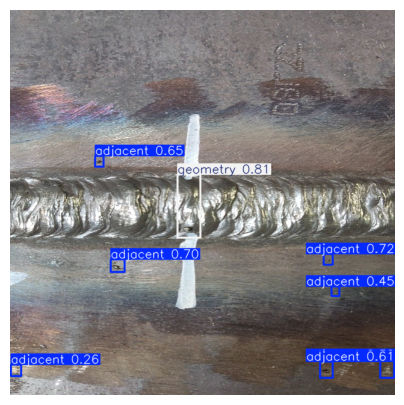

Found 0 objects in the image.


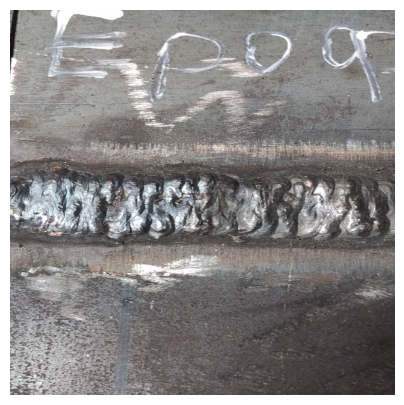

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.86
    Coordinates: [249.19883728027344, 306.99114990234375, 411.5299072265625, 412.69989013671875]


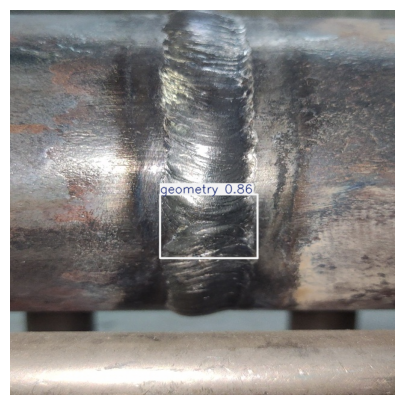

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.89
    Coordinates: [245.06805419921875, 223.31092834472656, 415.2772216796875, 328.49951171875]


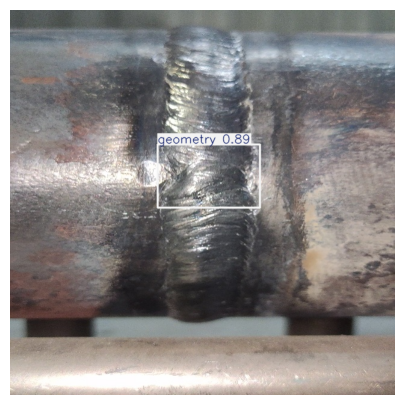

Found 2 objects in the image.
  - Defect: geometry
    Confidence: 0.81
    Coordinates: [86.17402648925781, 260.5513000488281, 146.97369384765625, 350.4670104980469]
  - Defect: integrity
    Confidence: 0.77
    Coordinates: [277.5329284667969, 252.59765625, 315.3098449707031, 274.861083984375]


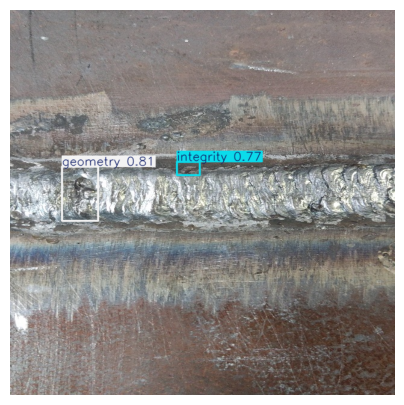

Found 1 objects in the image.
  - Defect: geometry
    Confidence: 0.80
    Coordinates: [233.35459899902344, 258.689697265625, 409.7373046875, 363.90118408203125]


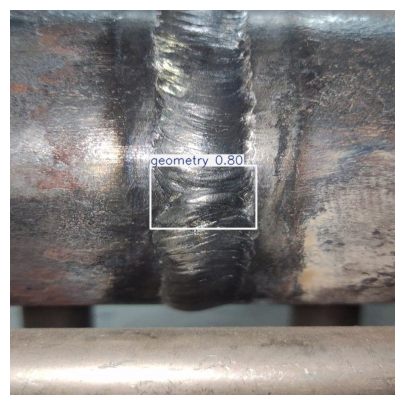

In [129]:
for result in results:
    print(f"Found {len(result.boxes)} objects in the image.")
    
    # Loop through each detected box
    for box in result.boxes:
        # Get coordinates [xmin, ymin, xmax, ymax]
        coordinates = box.xyxy[0]
        
        # Get the confidence score
        confidence = float(box.conf[0])
        
        # Get the class ID and name
        class_id = int(box.cls[0])
        class_name = result.names[class_id]
    
        print(f"  - Defect: {class_name}")
        print(f"    Confidence: {confidence:.2f}")
        print(f"    Coordinates: {coordinates.tolist()}")
    
    annotated_image = result.plot()
    rgb_image = annotated_image[..., ::-1]
    plt.figure(figsize=(5,5))
    plt.axis('off')
    plt.imshow(rgb_image)
    plt.show()